In [1]:
import wfdb
import matplotlib.pyplot as plt
import numpy as np
import os
from scipy.signal import medfilt
import pywt
from ecgdetectors import Detectors
from scipy.signal import resample_poly

nsr_data = ['./data/nsrdb/16265',
 './data/nsrdb/16272',
 './data/nsrdb/16273',
 './data/nsrdb/16420',
 './data/nsrdb/16483',
 './data/nsrdb/16539',
 './data/nsrdb/16773',
 './data/nsrdb/16786',
 './data/nsrdb/16795',
 './data/nsrdb/17052',
 './data/nsrdb/17453',
 './data/nsrdb/18177',
 './data/nsrdb/18184',
 './data/nsrdb/19088',
 './data/nsrdb/19090',
 './data/nsrdb/19093',
 './data/nsrdb/19140',
 './data/nsrdb/19830']

In [3]:
def extract_first_30min_and_segment(record_paths):
    """
    Given a list of NSR record paths (e.g. './data/nsrdb/16265'),
    1) Read the first 30 minutes of the ECG from each record
    2) Segment that 30-min signal into six 5-min parts
    3) Return a dictionary mapping record_name -> [segment1, segment2, ... segment6]
       Each segment is a NumPy array of shape (num_samples_5min, num_channels).
    """
    
    # For 30 min, we have 30 * 60 = 1800 seconds. 
    # For 5 min, we have 5 * 60 = 300 seconds.
    
    first_30min_segments = {}
    
    for record_path in record_paths:
        
        # Extract record name from path
        # e.g. record_path = "./data/nsrdb/16265" => record_name = "16265"
        record_dir, record_name = os.path.split(record_path)
      
        print(f"Processing {record_name} ...")
        
        # We want the first 30 minutes => 1800 seconds => num_samples = 1800 * fs
        fs = 128
        num_samples_30min = int(30 * 60 * fs)
        
        # Read from sample 0 to sample 0+num_samples_30min
        try:
            rec = wfdb.rdrecord(record_path, sampfrom=0, sampto=num_samples_30min)
        except Exception as e:
            print(f"[ERROR] Could not read {record_path}: {e}")
            continue
        
        if rec.p_signal is None:
            print(f"[WARN] No signal found in {record_name}. Skipping.")
            continue
        
        full_30min = rec.p_signal[:,0]
        
        # Segment the 30-min array into six 5-min parts
        # Each 5-min part = 5 * 60 * fs samples
        
        samples_5min = int(5 * 60 * fs)  # 300 seconds * 128 => 38400
        
        # We can slice in 6 equal blocks
        segments_5min = []
        for i in range(6):
            start_i = i * samples_5min
            end_i = start_i + samples_5min
            segment = full_30min[start_i:end_i]
            segments_5min.append(segment)
        
        # Store in a dictionary
        first_30min_segments[record_name] = segments_5min
        print(f"[OK] Extracted 6 segments of 5 min each from {record_name}.")
    
    return first_30min_segments

In [5]:
nsr_30min_segments_5min_each_6pc = extract_first_30min_and_segment(nsr_data)

Processing 16265 ...
[OK] Extracted 6 segments of 5 min each from 16265.
Processing 16272 ...
[OK] Extracted 6 segments of 5 min each from 16272.
Processing 16273 ...
[OK] Extracted 6 segments of 5 min each from 16273.
Processing 16420 ...
[OK] Extracted 6 segments of 5 min each from 16420.
Processing 16483 ...
[OK] Extracted 6 segments of 5 min each from 16483.
Processing 16539 ...
[OK] Extracted 6 segments of 5 min each from 16539.
Processing 16773 ...
[OK] Extracted 6 segments of 5 min each from 16773.
Processing 16786 ...
[OK] Extracted 6 segments of 5 min each from 16786.
Processing 16795 ...
[OK] Extracted 6 segments of 5 min each from 16795.
Processing 17052 ...
[OK] Extracted 6 segments of 5 min each from 17052.
Processing 17453 ...
[OK] Extracted 6 segments of 5 min each from 17453.
Processing 18177 ...
[OK] Extracted 6 segments of 5 min each from 18177.
Processing 18184 ...
[OK] Extracted 6 segments of 5 min each from 18184.
Processing 19088 ...
[OK] Extracted 6 segments of 5

In [7]:
nsr_30min_segments_5min_each_6pc

{'16265': [array([-0.165, -0.155, -0.195, ..., -0.295, -0.135, -0.295]),
  array([-0.285, -0.285, -0.185, ..., -0.365,  1.475,  2.795]),
  array([ 2.935,  2.535,  0.605, ..., -0.195, -0.145, -0.165]),
  array([-0.145, -0.115, -0.125, ..., -0.145, -0.145, -0.135]),
  array([-0.175, -0.135, -0.175, ..., -0.135, -0.135, -0.105]),
  array([-0.115, -0.125, -0.115, ..., -0.135, -0.175, -0.175])],
 '16272': [array([-0.185, -0.215, -0.215, ...,  0.055, -0.255, -0.205]),
  array([-0.175, -0.205, -0.175, ..., -0.085, -0.075, -0.055]),
  array([-0.085, -0.085, -0.095, ..., -0.095, -0.065, -0.005]),
  array([ 0.575,  1.135,  0.475, ..., -0.075, -0.065, -0.065]),
  array([-0.075, -0.075, -0.085, ...,  1.255, -0.115, -0.685]),
  array([-0.475, -0.155, -0.085, ..., -0.045, -0.045, -0.055])],
 '16273': [array([-0.305, -0.265, -0.245, ..., -0.015, -0.005, -0.005]),
  array([ 0.005,  0.035, -0.005, ...,  1.485,  2.755,  3.225]),
  array([ 1.925,  0.335, -0.205, ..., -0.135, -0.135, -0.135]),
  array([-0

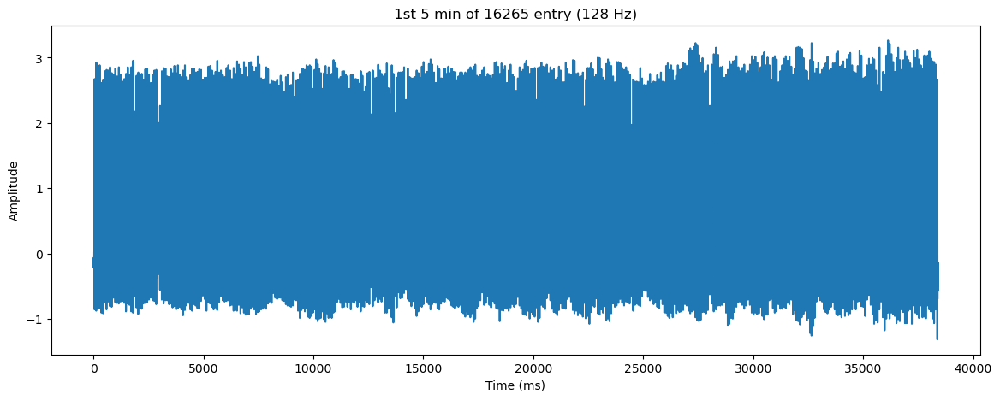

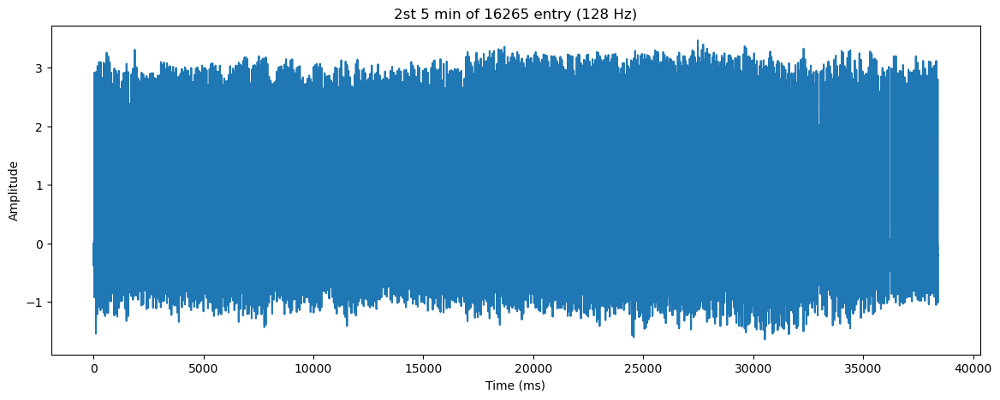

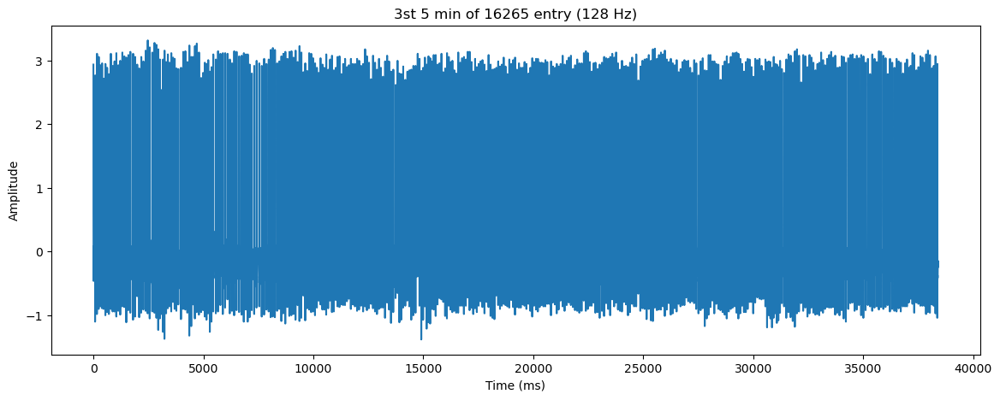

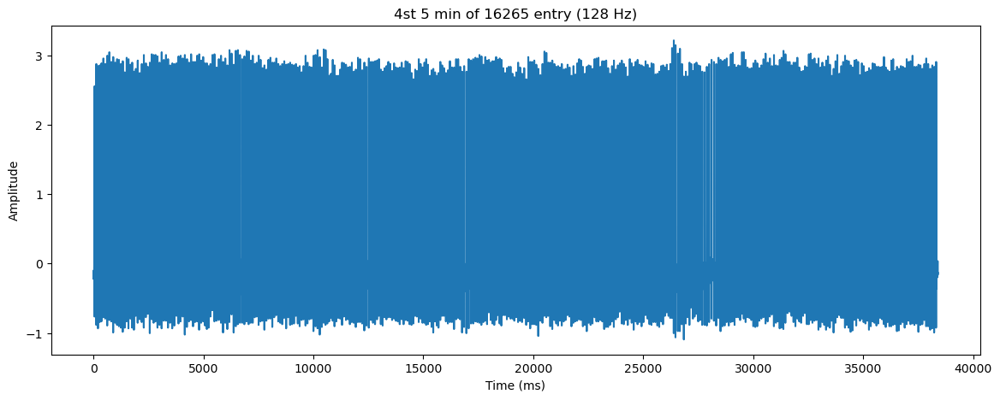

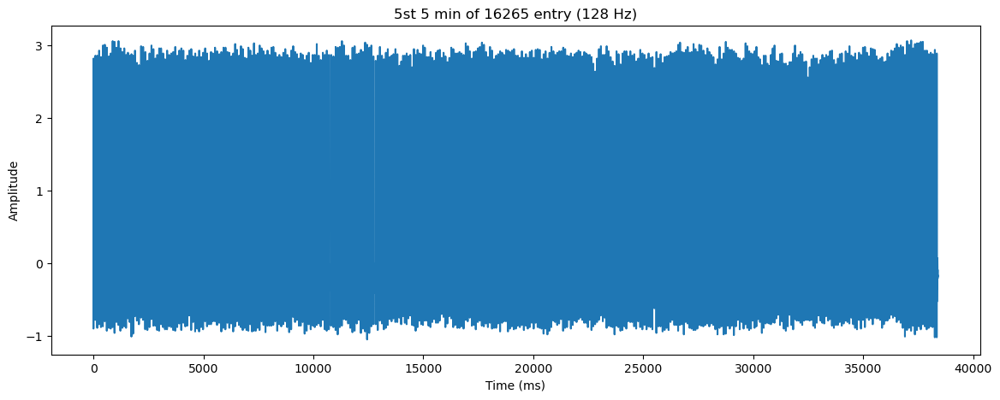

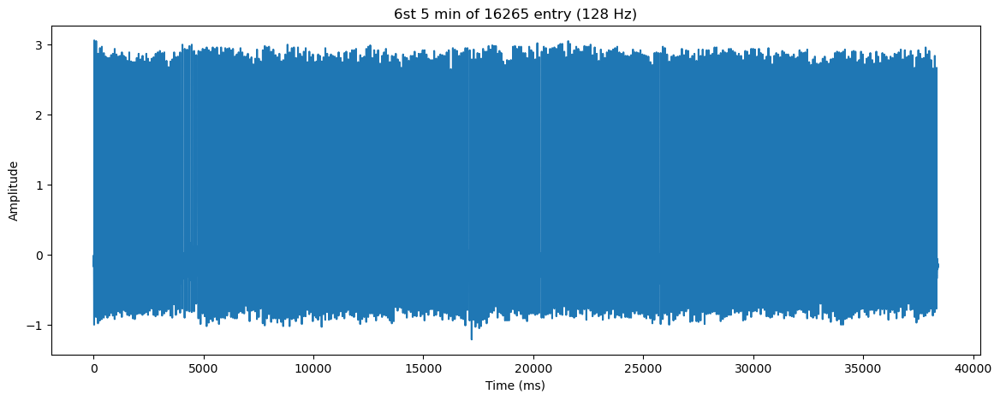

In [17]:
for i in range(6):
    five_min_OF_16265 = nsr_30min_segments_5min_each_6pc['16265'][i]
    plt.figure(figsize=(14, 5))
    plt.subplot()
    plt.plot(five_min_OF_16265)
    plt.title(f'{i+1}st 5 min of 16265 entry (128 Hz)')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')
    
    plt.show()

# Denoise

In [22]:
def denoise_signal(X, dwt_transform, dlevels, cutoff_low, cutoff_high):
    coeffs = pywt.wavedec(X, dwt_transform, level=dlevels)
    
    # scale 0 to cutoff_low 
    for ca in range(0,cutoff_low):
        coeffs[ca]=np.multiply(coeffs[ca],[0.0])
        
    # scale cutoff_high to end
    for ca in range(cutoff_high, len(coeffs)):
        coeffs[ca]=np.multiply(coeffs[ca],[0.0])
    Y = pywt.waverec(coeffs, dwt_transform) # inverse wavelet transform
    
    return Y  

In [24]:
rbiofam = ['rbio1.1', 'rbio1.3', 'rbio1.5', 'rbio2.2', 'rbio2.4', 'rbio2.6',
      'rbio2.8', 'rbio3.1', 'rbio3.3', 'rbio3.5', 'rbio3.7', 'rbio3.9', 
      'rbio4.4', 'rbio5.5', 'rbio6.8']

In [26]:
first_five_min_OF_16265 = nsr_30min_segments_5min_each_6pc['16265'][0]

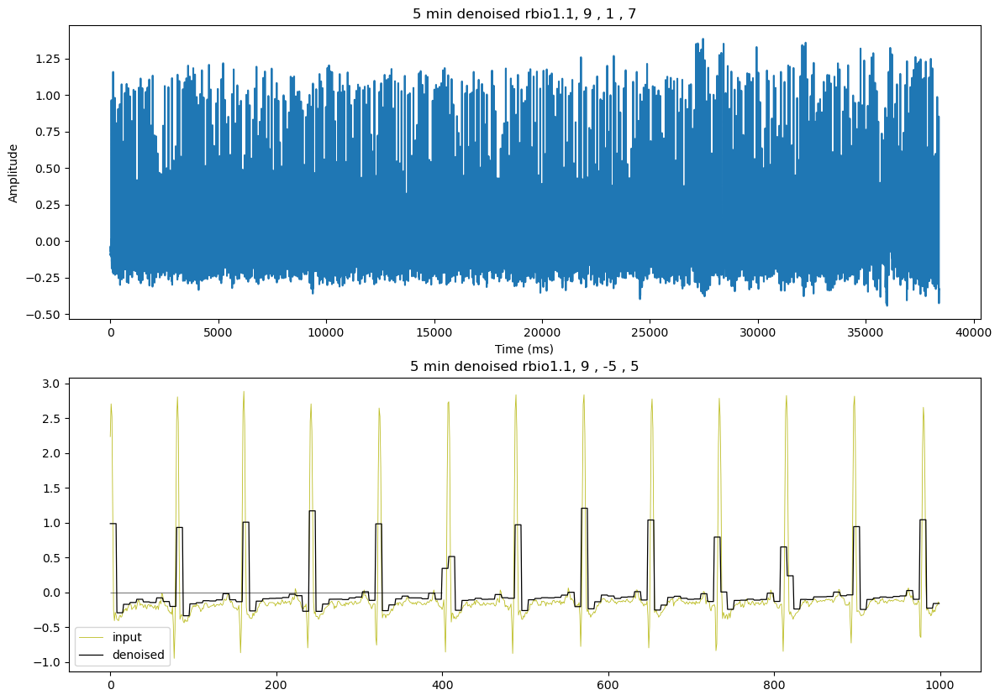

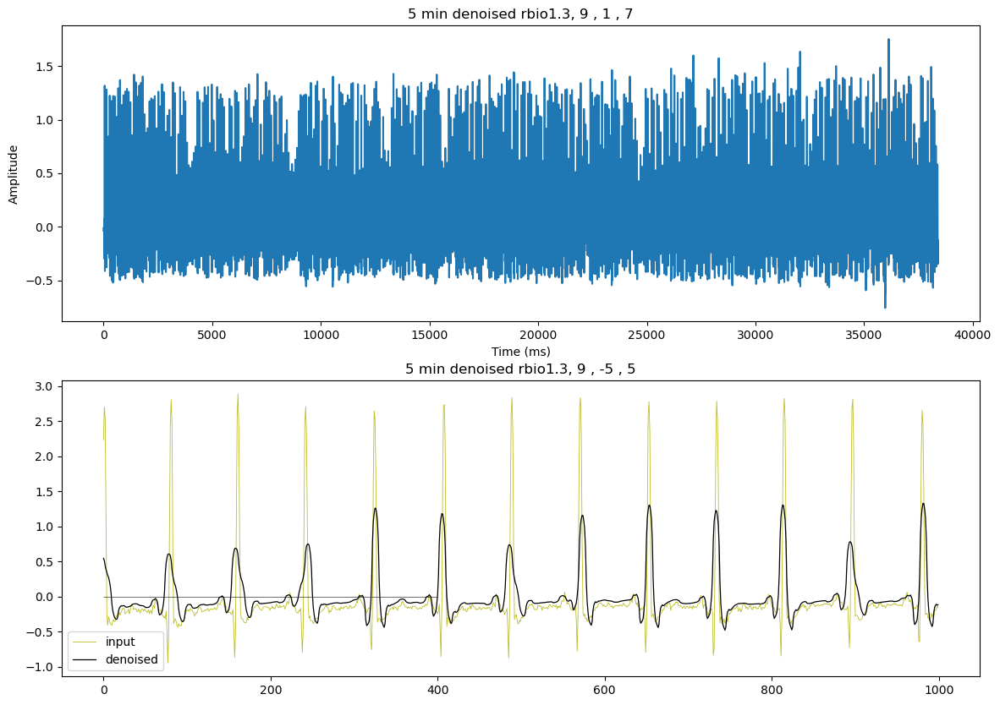

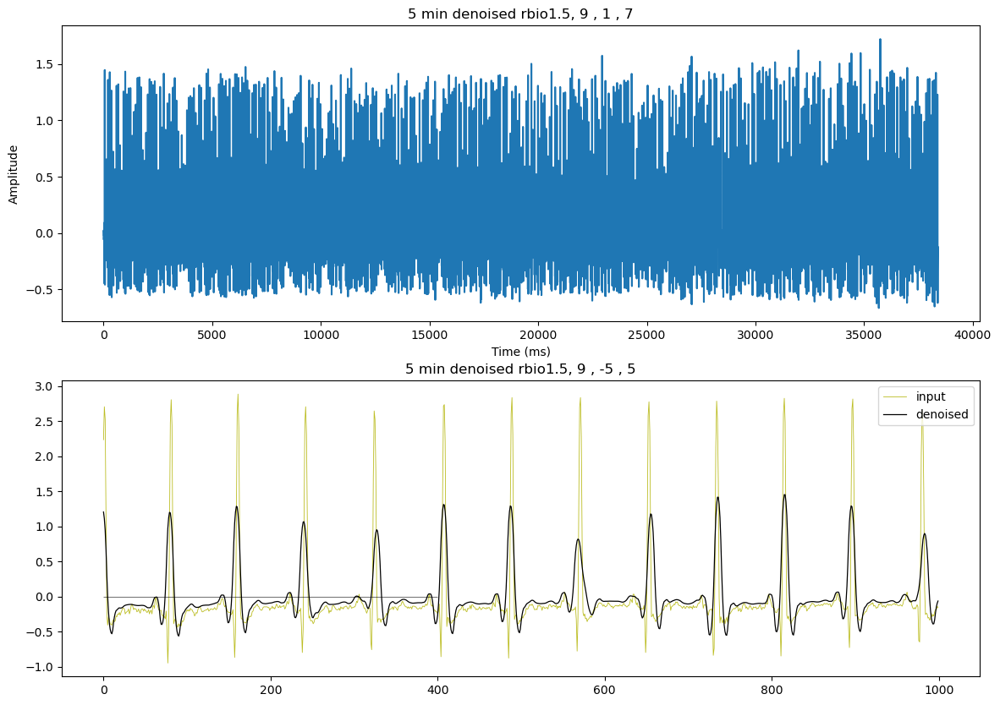

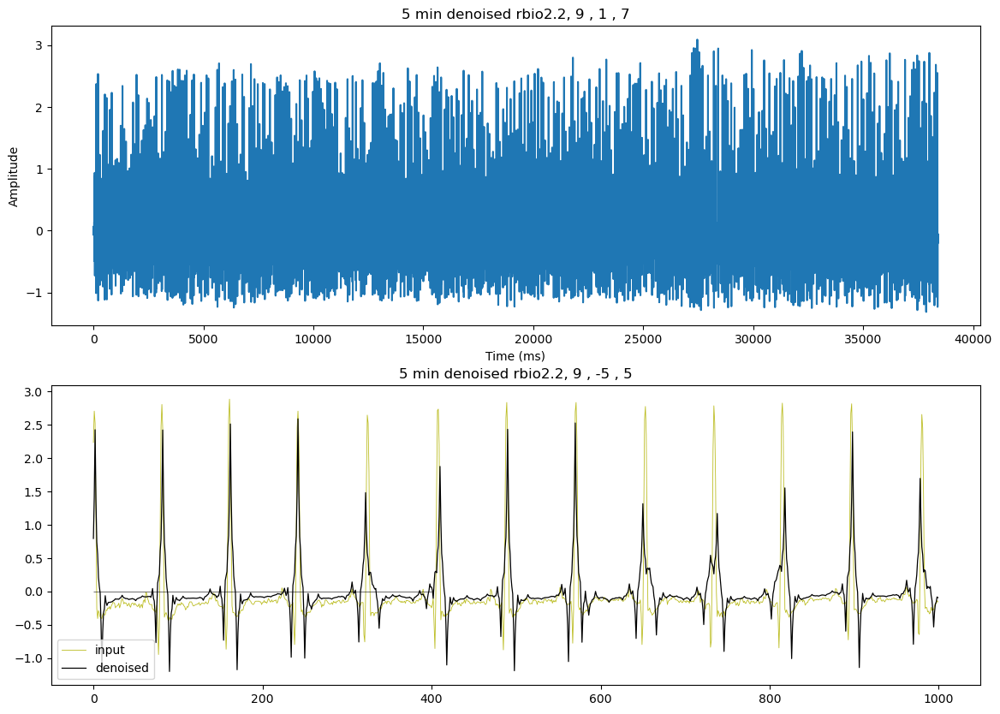

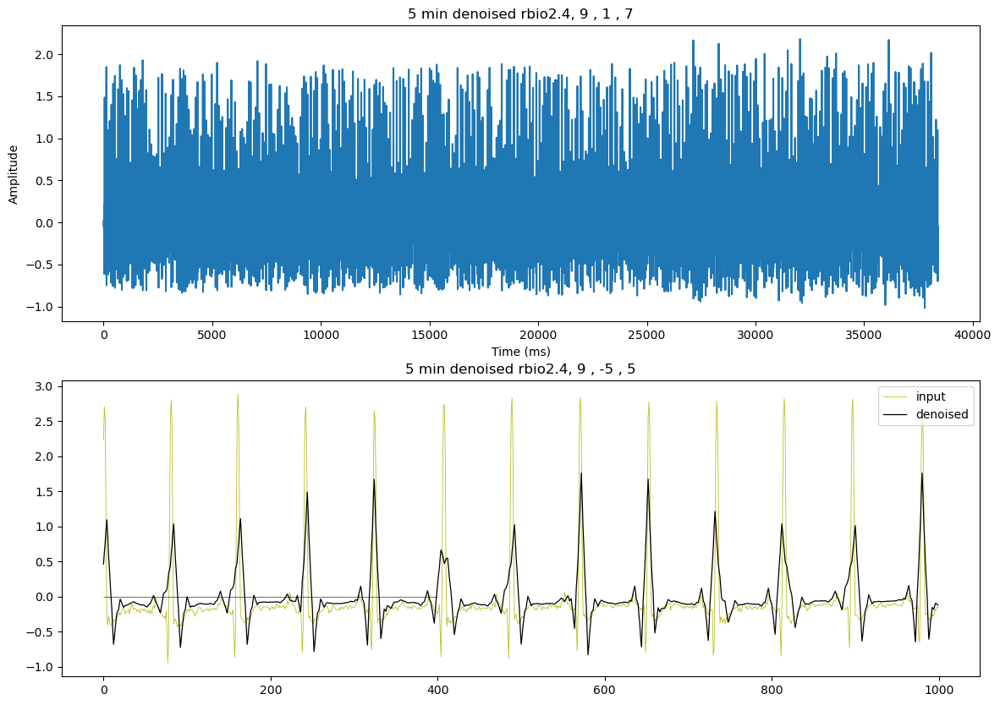

...

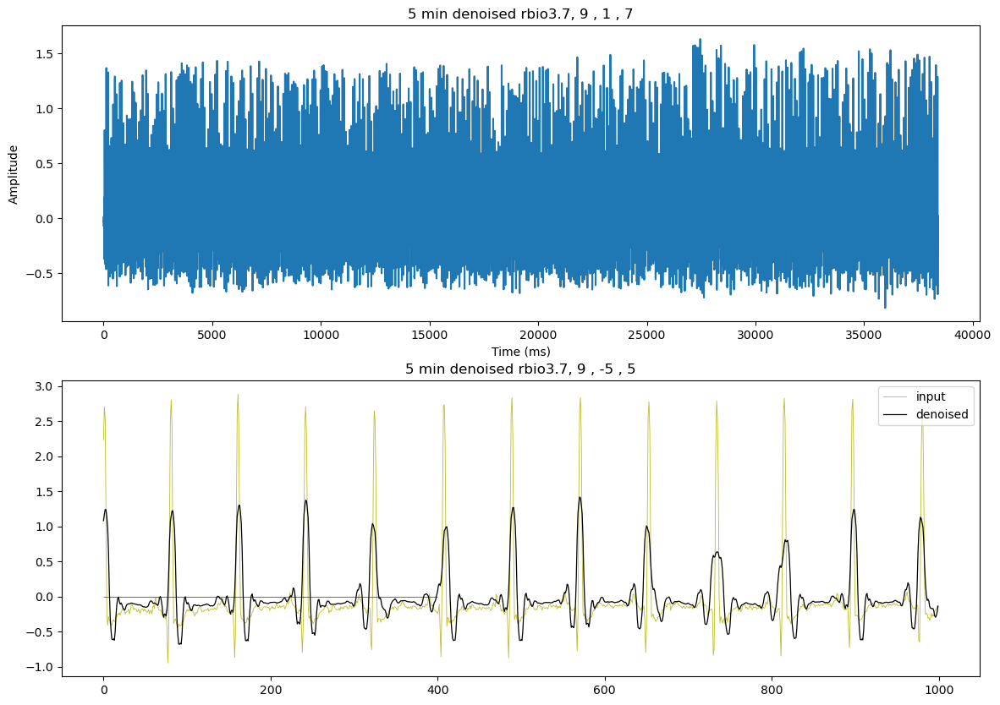

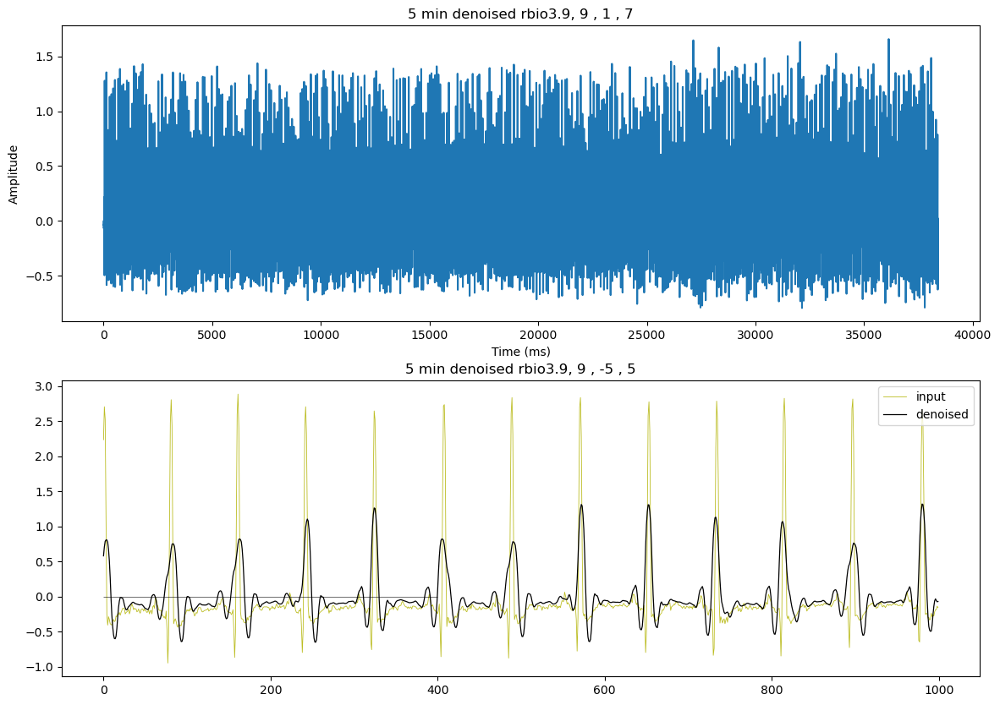

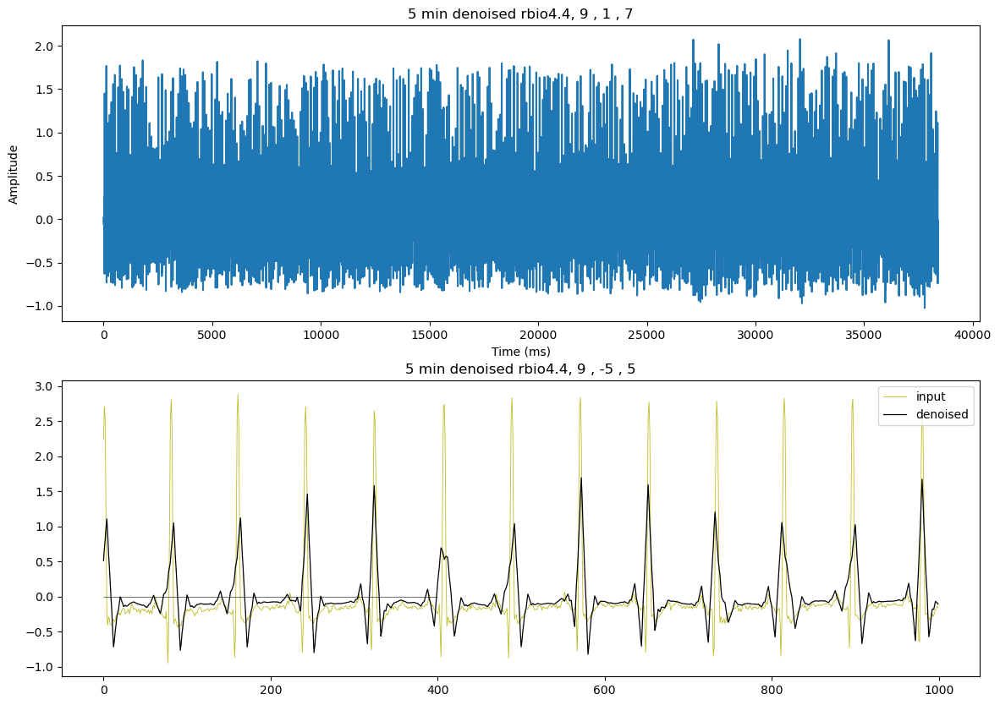

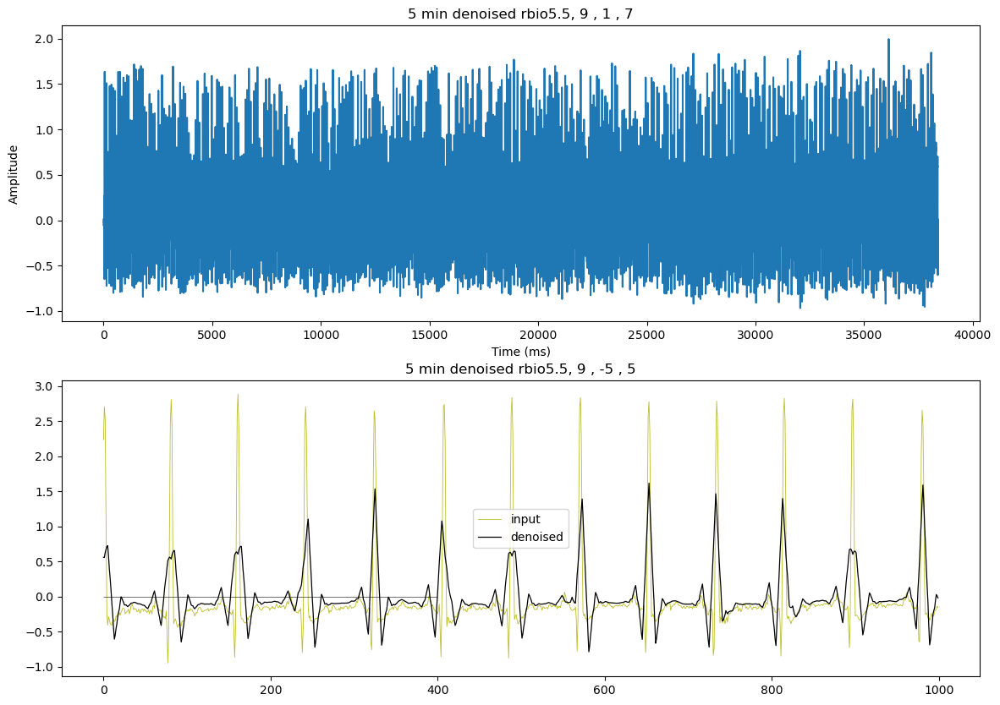

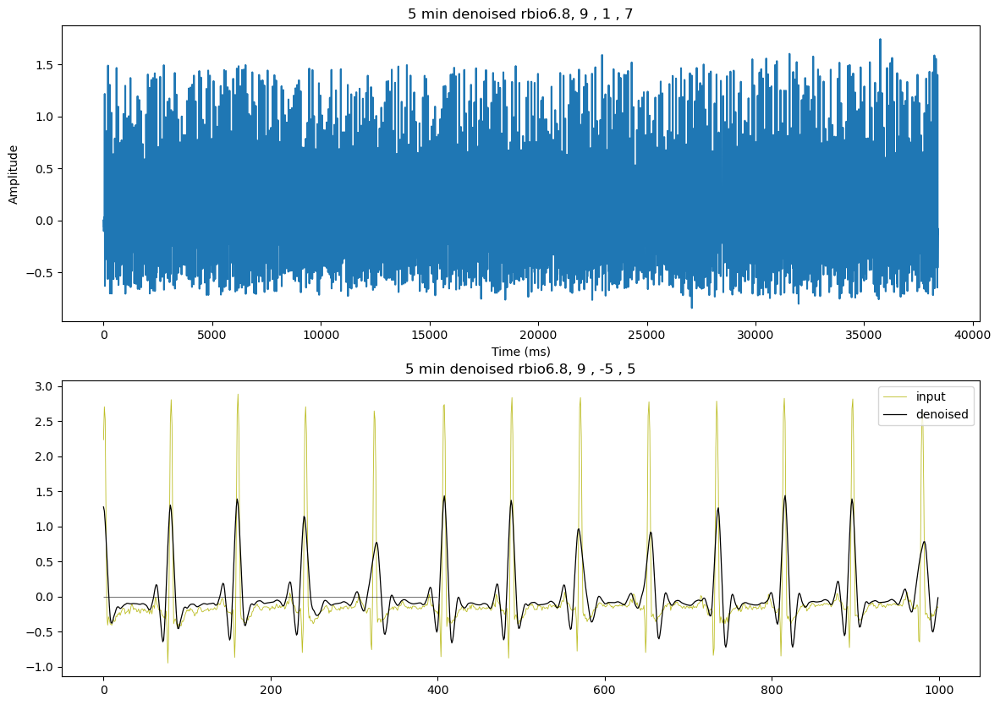

In [77]:
for i in range(len(rbiofam)):
    denoised_ex = denoise_signal(first_five_min_OF_16265, rbiofam[i], 9, 1 , 7)
    
    plt.figure(figsize=(14, 10))
    plt.subplot(2, 1, 1)
    plt.plot(denoised_ex)
    plt.title(f'5 min denoised {rbiofam[i]}, 9 , 1 , 7')
    plt.xlabel('Time (ms)')
    plt.ylabel('Amplitude')

    plt.subplot(2, 1, 2)
    plt.plot(first_five_min_OF_16265[4000:5000], color='tab:olive', linewidth=0.6,label = 'input')
    plt.title(f'5 min denoised {rbiofam[i]}, 9 , -5 , 5')
    plt.plot(denoised_ex[4000:5000], color='black', linewidth=0.9,label = 'denoised')
    plt.hlines(0,0,400,color='black', linewidth=0.4)
    plt.legend()
    plt.show()

In [79]:
denoised_rbior_1_3 = denoise_signal(first_five_min_OF_16265, 'rbio1.3', 9, 1 , 7)
denoised_rbior_1_5 = denoise_signal(first_five_min_OF_16265, 'rbio1.5', 9, 1 , 7)
denoised_rbior_6_8 = denoise_signal(first_five_min_OF_16265, 'rbio6.8', 9, 1 , 7)

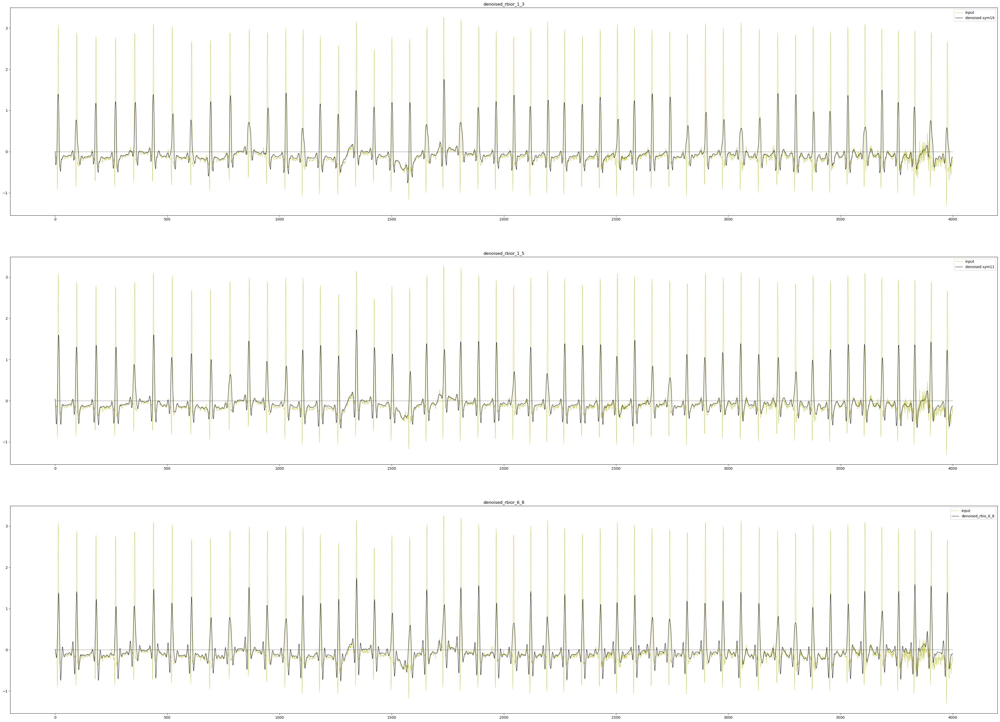

In [81]:
plt.figure(figsize=(50,36))
plt.subplot(3, 1, 1)
plt.plot(first_five_min_OF_16265[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_rbior_1_3[-4000:], color='black', linewidth=0.9,label = 'denoised sym19')
plt.title('denoised_rbior_1_3')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()

plt.subplot(3, 1, 2)
plt.plot(first_five_min_OF_16265[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_rbior_1_5[-4000:], color='black', linewidth=0.9,label = 'denoised sym11')
plt.title('denoised_rbior_1_5')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()

plt.subplot(3, 1, 3)
plt.plot(first_five_min_OF_16265[-4000:], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_rbior_6_8[-4000:], color='black', linewidth=0.9,label = 'denoised_rbio_6_8')
plt.title('denoised_rbior_6_8')
plt.hlines(0,0,4000,color='black', linewidth=0.4)
plt.legend()

plt.show()

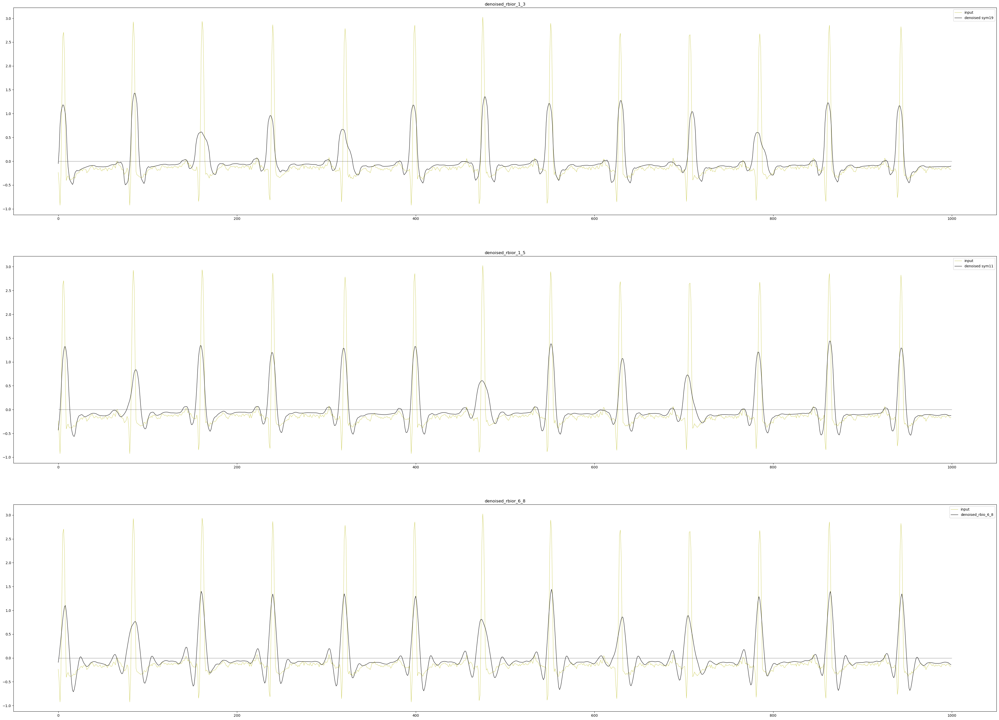

In [85]:
plt.figure(figsize=(50,36))
plt.subplot(3, 1, 1)
plt.plot(first_five_min_OF_16265[7000:8000], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_rbior_1_3[7000:8000], color='black', linewidth=0.9,label = 'denoised sym19')
plt.title('denoised_rbior_1_3')
plt.hlines(0,0,1000,color='black', linewidth=0.4)
plt.legend()

plt.subplot(3, 1, 2)
plt.plot(first_five_min_OF_16265[7000:8000], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_rbior_1_5[7000:8000], color='black', linewidth=0.9,label = 'denoised sym11')
plt.title('denoised_rbior_1_5')
plt.hlines(0,0,1000,color='black', linewidth=0.4)
plt.legend()

plt.subplot(3, 1, 3)
plt.plot(first_five_min_OF_16265[7000:8000], color='tab:olive', linewidth=0.6,label = 'input')
plt.plot(denoised_rbior_6_8[7000:8000], color='black', linewidth=0.9,label = 'denoised_rbio_6_8')
plt.title('denoised_rbior_6_8')
plt.hlines(0,0,1000,color='black', linewidth=0.4)
plt.legend()

plt.show()

# R peak

In [90]:
BASIC_SRATE = 128
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly

detectors = Detectors(BASIC_SRATE)
detectors = {
            'pan_tompkins_detector':[detectors.pan_tompkins_detector, []],
            'hamilton_detector':[detectors.hamilton_detector, []],
            'christov_detector':[detectors.christov_detector, []],
            'engzee_detector':[detectors.engzee_detector, []],
            'swt_detector':[detectors.swt_detector, []],
            'two_average_detector':[detectors.two_average_detector, []],
            }

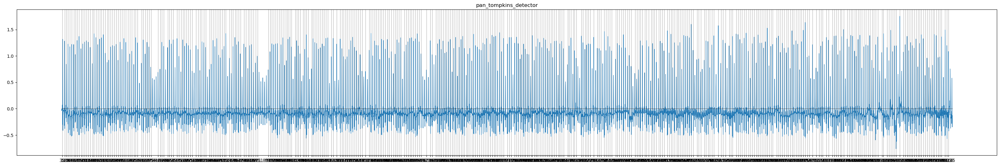

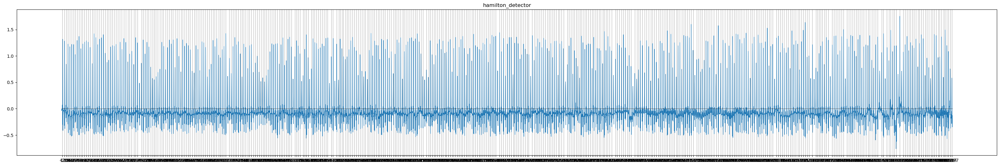

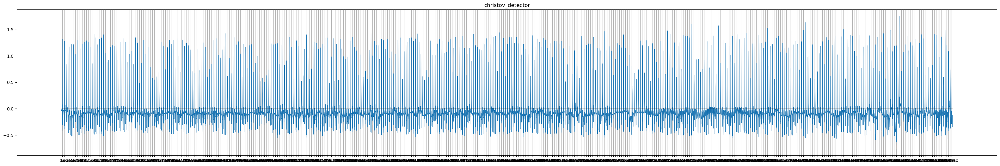

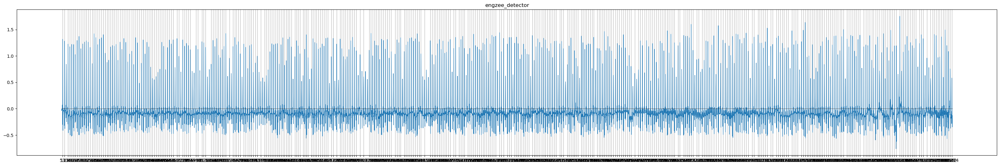

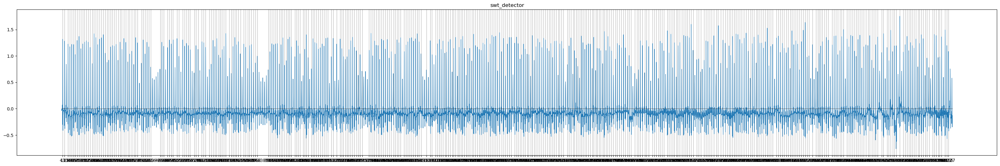

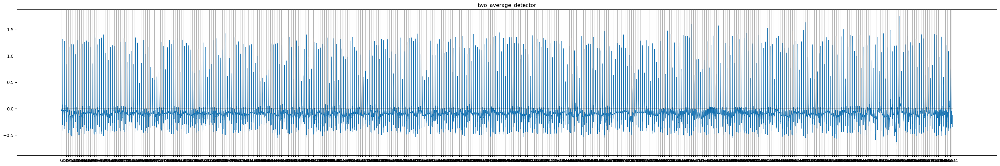

In [92]:
denoised_rbior_1_3_lf = denoised_rbior_1_3

for kd in detectors.keys():
    vd = detectors[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_rbior_1_3)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(denoised_rbior_1_3_lf,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,38400,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

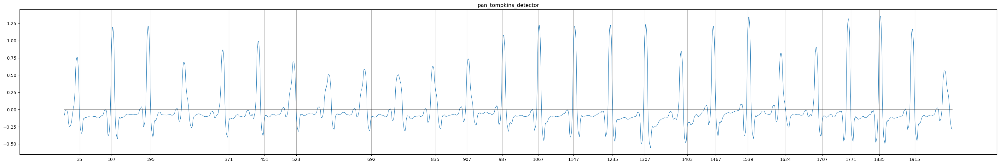

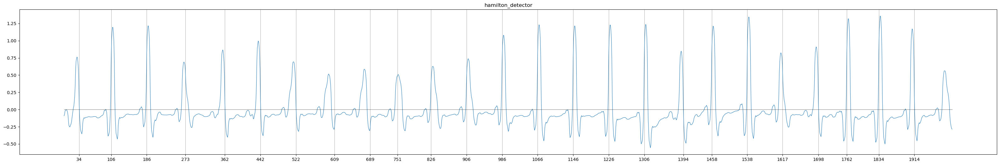

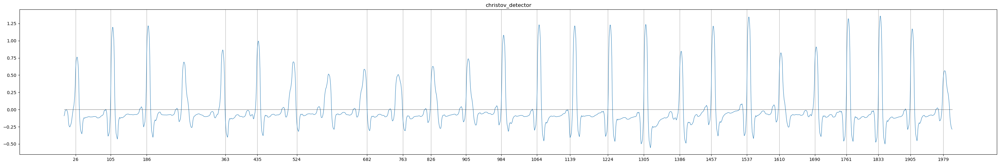

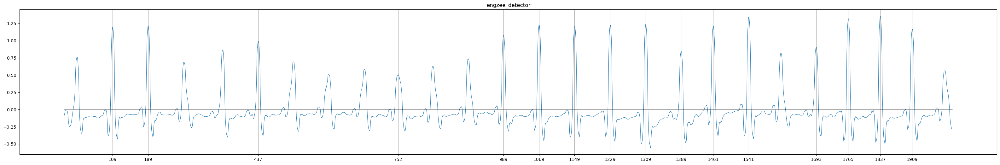

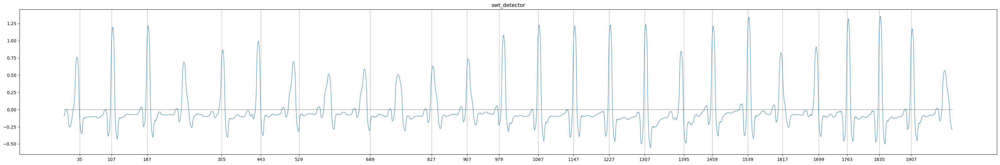

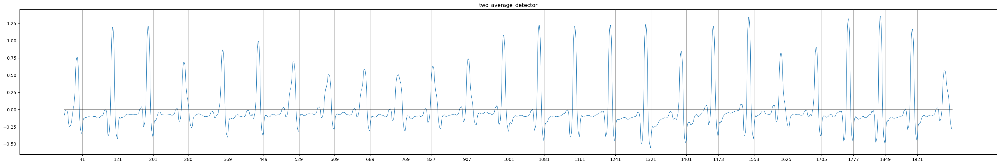

In [100]:
BASIC_SRATE = 128
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly

detectors_1 = Detectors(BASIC_SRATE)
detectors_1 = {
            'pan_tompkins_detector':[detectors_1.pan_tompkins_detector, []],
            'hamilton_detector':[detectors_1.hamilton_detector, []],
            'christov_detector':[detectors_1.christov_detector, []],
            'engzee_detector':[detectors_1.engzee_detector, []],
            'swt_detector':[detectors_1.swt_detector, []],
            'two_average_detector':[detectors_1.two_average_detector, []],
            }

denoised_rbior_1_3_lf_1 = denoised_rbior_1_3

for kd in detectors_1.keys():
    vd = detectors_1[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_rbior_1_3[8000:10000])))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(denoised_rbior_1_3_lf_1[8000:10000],color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,2000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

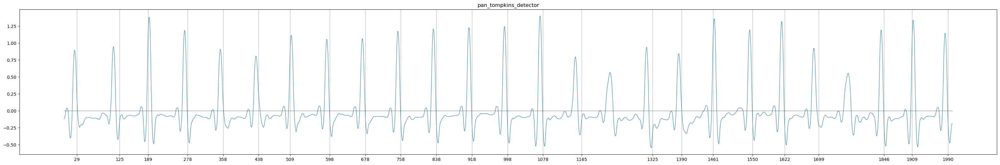

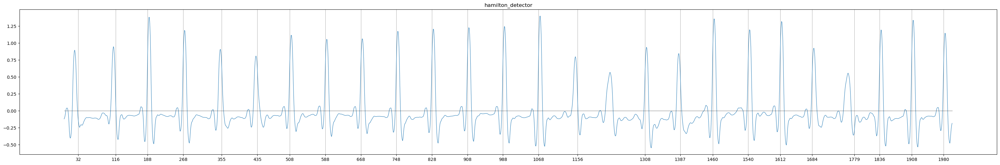

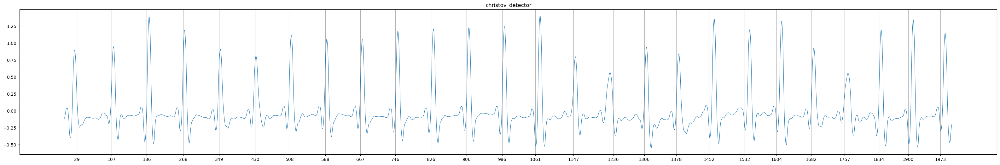

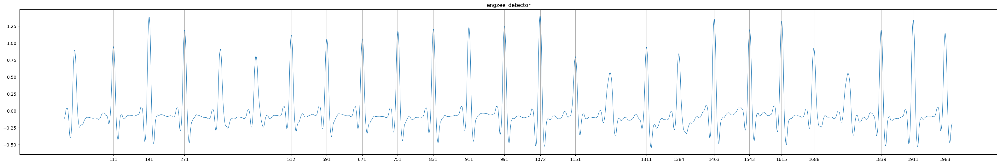

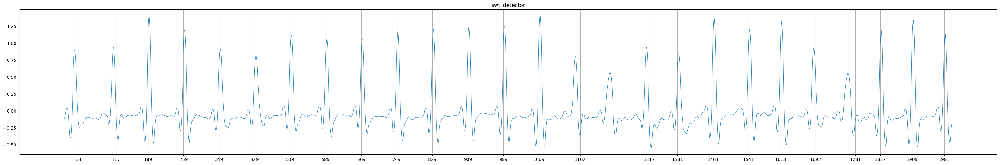

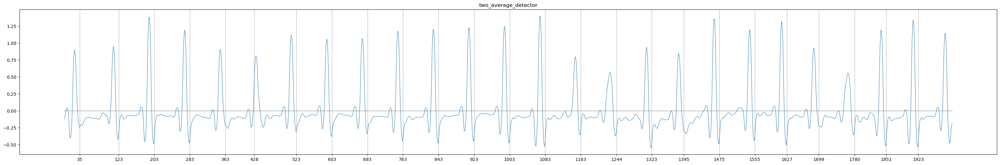

In [102]:
BASIC_SRATE = 128
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly

detectors_2 = Detectors(BASIC_SRATE)
detectors_2 = {
            'pan_tompkins_detector':[detectors_2.pan_tompkins_detector, []],
            'hamilton_detector':[detectors_2.hamilton_detector, []],
            'christov_detector':[detectors_2.christov_detector, []],
            'engzee_detector':[detectors_2.engzee_detector, []],
            'swt_detector':[detectors_2.swt_detector, []],
            'two_average_detector':[detectors_2.two_average_detector, []],
            }

denoised_rbior_1_5_lf_1 = denoised_rbior_1_5

for kd in detectors_2.keys():
    vd = detectors_2[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_rbior_1_5[8000:10000])))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(denoised_rbior_1_5_lf_1[8000:10000],color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,2000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

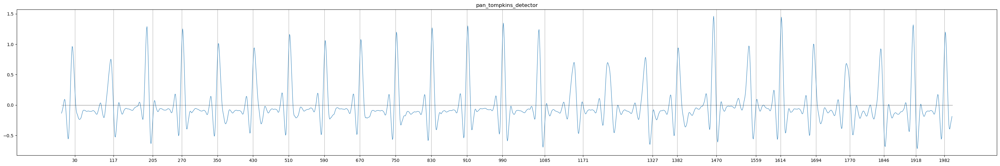

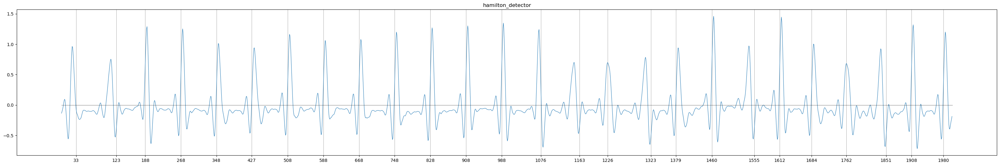

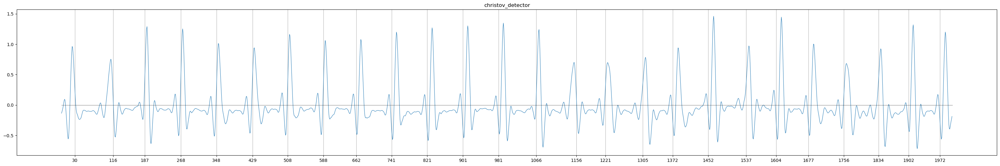

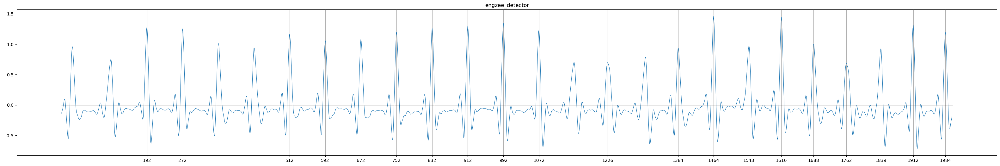

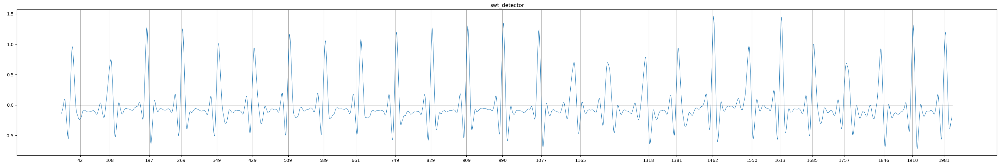

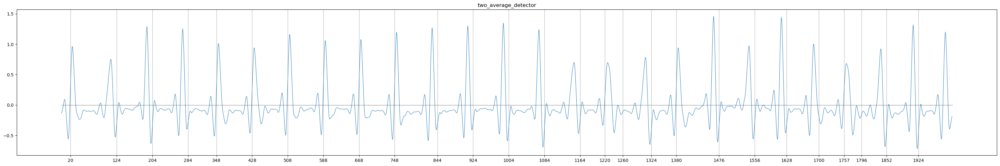

In [104]:
BASIC_SRATE = 128
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly

detectors_3 = Detectors(BASIC_SRATE)
detectors_3 = {
            'pan_tompkins_detector':[detectors_3.pan_tompkins_detector, []],
            'hamilton_detector':[detectors_3.hamilton_detector, []],
            'christov_detector':[detectors_3.christov_detector, []],
            'engzee_detector':[detectors_3.engzee_detector, []],
            'swt_detector':[detectors_3.swt_detector, []],
            'two_average_detector':[detectors_3.two_average_detector, []],
            }

denoised_rbior_6_8_lf_1 = denoised_rbior_6_8

for kd in detectors_3.keys():
    vd = detectors_3[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_rbior_6_8[8000:10000])))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(denoised_rbior_6_8_lf_1[8000:10000],color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,2000,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

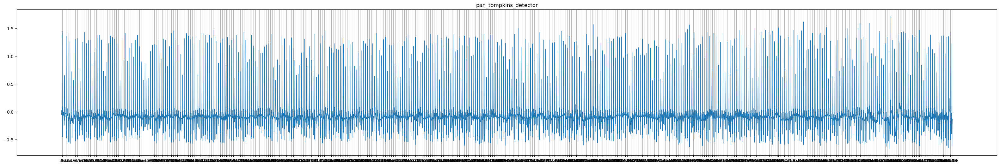

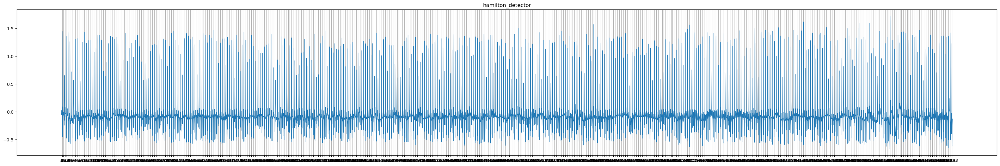

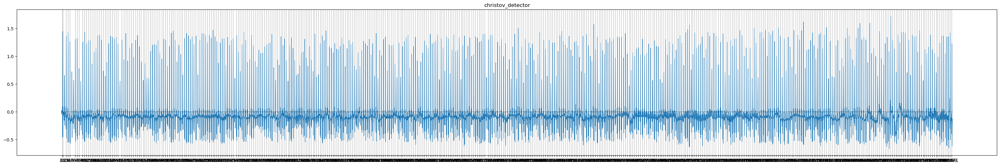

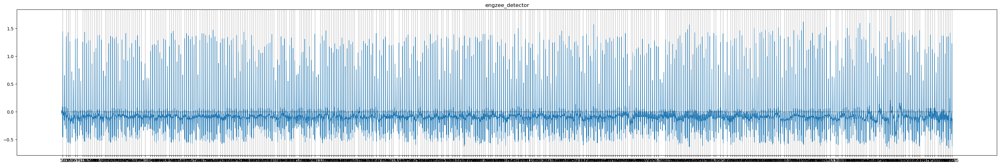

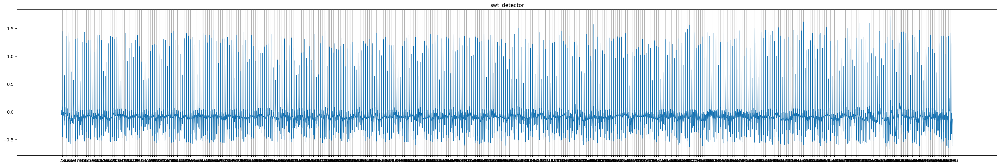

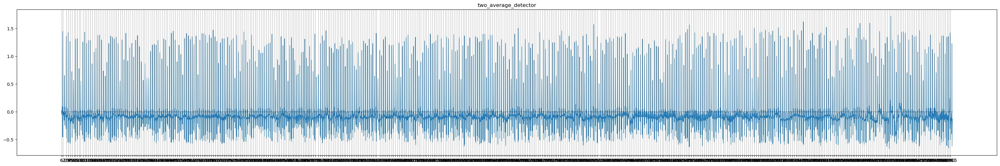

In [107]:
BASIC_SRATE = 128
signal_pad_samples = 10
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly
denoised_rbior_1_5_detector = Detectors(BASIC_SRATE)
denoised_rbior_1_5_detector = {
            'pan_tompkins_detector':[denoised_rbior_1_5_detector.pan_tompkins_detector, []],
            'hamilton_detector':[denoised_rbior_1_5_detector.hamilton_detector, []],
            'christov_detector':[denoised_rbior_1_5_detector.christov_detector, []],
            'engzee_detector':[denoised_rbior_1_5_detector.engzee_detector, []],
            'swt_detector':[denoised_rbior_1_5_detector.swt_detector, []],
            'two_average_detector':[denoised_rbior_1_5_detector.two_average_detector, []],
            }


denoised_rbior_1_5_lf = denoised_rbior_1_5

for kd in denoised_rbior_1_5_detector.keys():
    vd = denoised_rbior_1_5_detector[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_rbior_1_5)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(40,6))
    plt.title(kd)
    plt.plot(denoised_rbior_1_5_lf,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,38400,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

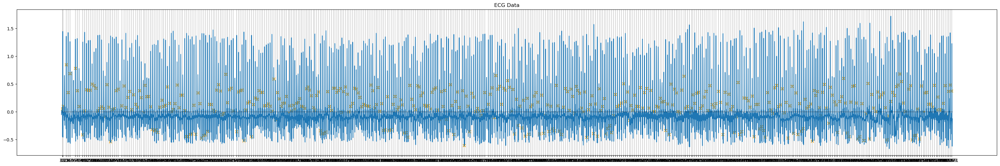

In [109]:
denoised_rbior_1_5_lf_ = denoised_rbior_1_5_lf
data_peaks_rbior_68_christov = denoised_rbior_1_5_detector['christov_detector'][1]

plt.figure(figsize=(40,6))
plt.title('ECG Data')
plt.plot(denoised_rbior_1_5_lf_)
plt.scatter(data_peaks_rbior_68_christov, denoised_rbior_1_5_lf_[data_peaks_rbior_68_christov], color='orange', marker='x', label='R-peaks')
plt.hlines(0,0,38400,color='black', linewidth=0.4)
plt.xticks(data_peaks_rbior_68_christov)
plt.grid(axis='x')
plt.show()

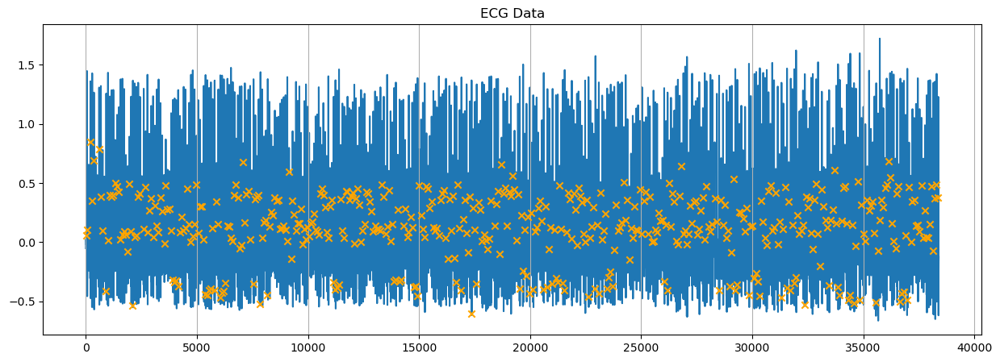

In [111]:
plt.figure(figsize=(15,5))
plt.title('ECG Data')
plt.scatter(data_peaks_rbior_68_christov, denoised_rbior_1_5_lf_[data_peaks_rbior_68_christov], color='orange', marker='x', label='R-peaks', zorder=2)
plt.plot(denoised_rbior_1_5_lf_, zorder=1)
plt.grid(axis='x')
plt.show()

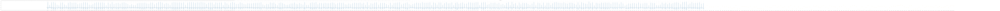

In [117]:
denoised_rbior_1_5_lf_ = denoised_rbior_1_5_lf
data_peaks_rbior_68_christov = denoised_rbior_1_5_detector['christov_detector'][1]

plt.figure(figsize=(600,6))
plt.title('ECG Data')
plt.plot(denoised_rbior_1_5_lf_)
plt.scatter(data_peaks_rbior_68_christov, denoised_rbior_1_5_lf_[data_peaks_rbior_68_christov], color='orange', marker='x', label='R-peaks')
plt.hlines(0,0,38400,color='black', linewidth=0.4)
plt.xticks(data_peaks_rbior_68_christov)
plt.grid(axis='x')
plt.show()

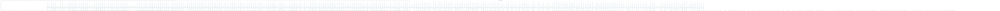

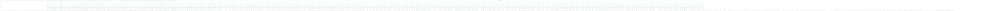

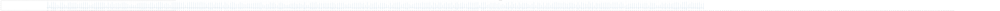

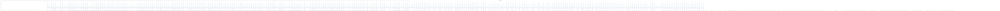

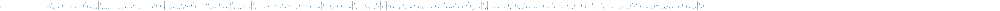

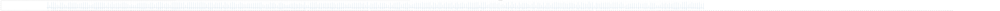

In [122]:
BASIC_SRATE = 128
signal_pad_samples = 0
signal_pad = np.zeros(signal_pad_samples) # pad one sec to detect initial peaks properly
denoised_rbior_1_5_detector_new = Detectors(BASIC_SRATE)
denoised_rbior_1_5_detector_new = {
            'pan_tompkins_detector':[denoised_rbior_1_5_detector_new.pan_tompkins_detector, []],
            'hamilton_detector':[denoised_rbior_1_5_detector_new.hamilton_detector, []],
            'christov_detector':[denoised_rbior_1_5_detector_new.christov_detector, []],
            'engzee_detector':[denoised_rbior_1_5_detector_new.engzee_detector, []],
            'swt_detector':[denoised_rbior_1_5_detector_new.swt_detector, []],
            'two_average_detector':[denoised_rbior_1_5_detector_new.two_average_detector, []],
            }


denoised_rbior_1_5_lf = denoised_rbior_1_5

for kd in denoised_rbior_1_5_detector_new.keys():
    vd = denoised_rbior_1_5_detector_new[kd]
    r_peaks = np.array(vd[0](np.hstack((signal_pad,denoised_rbior_1_5)))) - signal_pad_samples
    vd[1] = r_peaks
    plt.figure(figsize=(600,6))
    plt.title(kd)
    plt.plot(denoised_rbior_1_5_lf,color='tab:blue',linewidth=0.8)
    plt.hlines(0,0,38400,color='black', linewidth=0.4)
    plt.xticks(r_peaks)
    plt.grid(axis='x')
    plt.show()

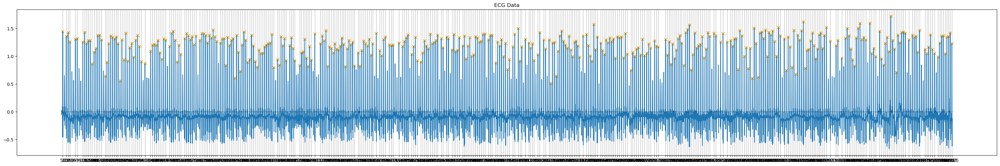

In [124]:
denoised_rbior_1_5_lf_ = denoised_rbior_1_5_lf
data_peaks_rbior_68_christov = denoised_rbior_1_5_detector_new['engzee_detector'][1]

plt.figure(figsize=(40,6))
plt.title('ECG Data')
plt.plot(denoised_rbior_1_5_lf_)
plt.scatter(data_peaks_rbior_68_christov, denoised_rbior_1_5_lf_[data_peaks_rbior_68_christov], color='orange', marker='x', label='R-peaks')
plt.hlines(0,0,38400,color='black', linewidth=0.4)
plt.xticks(data_peaks_rbior_68_christov)
plt.grid(axis='x')
plt.show()

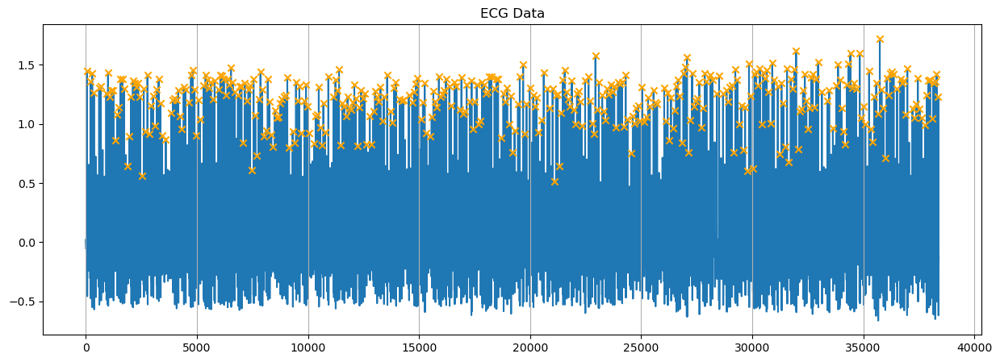

In [126]:
plt.figure(figsize=(15,5))
plt.title('ECG Data')
plt.scatter(data_peaks_rbior_68_christov, denoised_rbior_1_5_lf_[data_peaks_rbior_68_christov], color='orange', marker='x', label='R-peaks', zorder=2)
plt.plot(denoised_rbior_1_5_lf_, zorder=1)
plt.grid(axis='x')
plt.show()